# Julia Drop Simulations


## Prior Package Installations

It is necessary to have the Julia kernel installed before using this notebook. Instructions can be found here: https://julialang.github.io/IJulia.jl/stable/manual/installation/.


In [1]:
# using Pkg; Pkg.add("IJulia")

Other package installations may be required. The main known ones are listed below. They can be added through this notebook, or the Julia CLI. You may expect a few minutes for this to be completed. Once the packages are installed once in a session, there is no need to install them again, as opposed to fecthing imports.


In [2]:
# import Pkg; Pkg.add("Animations")
# import Pkg; Pkg.add("Colors")
# import Pkg; Pkg.add("ColorSchemes")
# import Pkg; Pkg.add("GLMakie")

## Main imports

In [3]:
using LinearAlgebra
using SpecialFunctions
using FastGaussQuadrature
using DelimitedFiles
using ProgressMeter
using Printf
using LegendrePolynomials
using ColorSchemes

# For 3D plotting and animation
using Plots
using GeometryBasics: Point3f0, TriangleFace, Mesh 
using GLMakie  
using CairoMakie
using Statistics
using Animations
using Colors
plotlyjs() 

WebIO._IJuliaInit()

Plots.PlotlyJSBackend()

## User input


In [4]:
#Physical ants
rho_in_CGS = 1 #Gr/cm^3
sigma_in_CGS = 72 #Dyne/cm
g_in_CGS = 980 #Cm/s2
nu_in_GCS = 0.01 #cm2/s

#Geometry
R_in_CGS = .02 #Cm

#Initial speed in meters per second
V_in_CGS = 30 #Cm/s

#Total simulation time
T_end = 5 #In dimensionless units

#Numerical parameters
n_thetas = 40
n_sampling_time_L_mode = 16 #Not any less than 8

16

Constants derived directly from user input


In [5]:
# Initial height
H_in_CGS = R_in_CGS # centimeter-gram-second

# Units
unit_length_in_CGS = R_in_CGS
unit_time_in_CGS = sqrt(rho_in_CGS * R_in_CGS^3 / sigma_in_CGS)
unit_mass_in_CGS = rho_in_CGS * R_in_CGS^3

# Dimensionless constants
We = rho_in_CGS * V_in_CGS^2 * R_in_CGS / sigma_in_CGS
Bo = rho_in_CGS * g_in_CGS * R_in_CGS^2 / sigma_in_CGS
Oh = nu_in_GCS * sqrt(rho_in_CGS / (sigma_in_CGS * R_in_CGS))

# Numerical constants
delta_time_max = (2 * π) / (sqrt(n_thetas * (n_thetas + 2) * (n_thetas - 1)) * n_sampling_time_L_mode)
n_times_base = ceil(Int, T_end / delta_time_max)

# Initialize list of times
times_list = collect(0:delta_time_max:(n_times_base * delta_time_max))

# Dimensionless initial conditions
V = -sqrt(We)
H = H_in_CGS / unit_length_in_CGS

# Define vector of cosines of the sampled angles
roots, weights = gausslegendre(n_thetas)
cos_theta_vec = vcat(1, reverse(roots))
theta_vec = acos.(cos_theta_vec)
q_last = findfirst(x -> x <= 0, cos_theta_vec) - 1

21

## Helper Functions


In [6]:
function Legendre(x::Float64, n::Int)
  """
  Function that evaluates nth Legendre polynomial at x using the LegendrePolynomials package.

  Inputs:
  - x (Float64): X-value at which Legendre polynomial is evaluated
  - n (Int): Number of Legendre polynomial to be evaluated

  Output:
  - value (Float64): Value of nth Legendre polynomial at x
  """
    if n == n_thetas && x != 1
        # To avoid numerical errors very close to zero
        value = 0.0
    else
        value = LegendrePolynomials.Pl(x, n)
    end
    return value
end

Legendre (generic function with 1 method)

In [7]:
function matrix(delta_t, q)
    """
    Function that returns the matrix M for the time evolution of the Legendre modes.
    This matrix is constructed based on the Legendre polynomial properties and the physical parameters of the system.

    Inputs:
    - delta_t (Float64): Time step for the evolution
    - q (Int64): Number of guessed contact points.

    Output:
    - M_mat: Matrix{Float64}: The matrix representing the system's evolution in Legendre modes
    """
    # Assumes global variables n_thetas and cos_theta_vec are defined

    # First Block Row (time evolution of the Legendre mode amplitudes)
    # This block uses the Legendre polynomial properties to evolve the modes over time
    Identity_n_thetas_min_1_mat = I(n_thetas - 1)
    M_mat = hcat(Identity_n_thetas_min_1_mat,
                 -delta_t * Identity_n_thetas_min_1_mat,
                 zeros(n_thetas - 1, n_thetas + 1),
                 zeros(n_thetas - 1, 1),
                 zeros(n_thetas - 1, 1))

    # Second Block Row (coupling between Legendre modes due to surface tension and other effects)
    # This block uses the Legendre polynomial properties to combine modes
    C_list = [(l - 1) * l * (l + 2) for l in 2:n_thetas]
    C_mat = Diagonal(C_list)
    D_list = [l for l in 2:n_thetas]
    D_mat = hcat(zeros(n_thetas - 1, 2), Diagonal(D_list))
    second_block_row = hcat(delta_t * C_mat,
                            Identity_n_thetas_min_1_mat,
                            delta_t * D_mat,
                            zeros(n_thetas - 1, 1),
                            zeros(n_thetas - 1, 1))
    M_mat = vcat(M_mat, second_block_row)

    # Third Block Row (contact point conditions)
    # This block uses the Legendre polynomial properties to enforce contact conditions at q points
    EG_mat = zeros(n_thetas + 1, n_thetas + 1)
    for ind_angle in 1:(n_thetas + 1)
        for ind_poly in 1:(n_thetas + 1)
            # Using degree (ind_poly - 1) because Legendre polynomials are 0-indexed by definition, and Julia is 1-indexed
            EG_mat[ind_angle, ind_poly] = Legendre(cos_theta_vec[ind_angle], ind_poly - 1)
        end
    end
    E_mat = EG_mat[1:q, 3:end]  # Columns 3 to end for index offset due to Legendre mode skipping 0 and 1 (1 and 2 in Julia)
    G_mat = EG_mat[(q+1):end, :]
    F_vec = -1.0 ./ cos_theta_vec[1:q]
    F_vec = reshape(F_vec, q, 1)
    third_block_row = hcat(E_mat,
                           zeros(q, n_thetas - 1),
                           zeros(q, n_thetas + 1),
                           F_vec,
                           zeros(q, 1))

    # Fourth Block Row (remaining contact point conditions)
    # This block uses the Legendre polynomial properties to enforce contact conditions at remaining points
    fourth_block_row = hcat(zeros(n_thetas + 1 - q, n_thetas - 1),
                            zeros(n_thetas + 1 - q, n_thetas - 1),
                            G_mat,
                            zeros(n_thetas + 1 - q, 1),
                            zeros(n_thetas + 1 - q, 1))
    M_mat = vcat(M_mat, third_block_row, fourth_block_row)

    # Fifth Block Row (represents the center of mass evolution)
    # This block uses the Legendre polynomial properties to evolve the center of mass
    fifth_block_row = hcat(zeros(1, n_thetas - 1),
                           zeros(1, n_thetas - 1),
                           zeros(1, n_thetas + 1),
                           [1.0],
                           [-delta_t])
    M_mat = vcat(M_mat, fifth_block_row)

    # Sixth Block Row (fixes the second Legendre mode component, which is related to the height of the contact line)
    # This block uses the Legendre polynomial properties to fix the second mode component
    # This is necessary to ensure the contact line height remains constant and doesn't drift due to numerical errors
    H = zeros(1, n_thetas + 1)
    H[1, 2] = -1.0  # 1-based indexing in Julia; 2nd column is index 2
    sixth_block_row = hcat(zeros(1, n_thetas - 1),
                           zeros(1, n_thetas - 1),
                           delta_t * H,
                           [0.0],
                           [1.0])
    M_mat = vcat(M_mat, sixth_block_row)

    return M_mat # Return the constructed matrix
end


matrix (generic function with 1 method)

In [8]:
condition_number(matrix) = cond(matrix) # (OPTIONAL) Function to compute the condition number of a matrix, which is used for numerical stability analysis and this is important for ensuring the accuracy of the numerical solution. 

condition_number (generic function with 1 method)

In [9]:
function error(amplitudes_vec, h, q)
    """
    Function that calculates the error of q contact points, which represents the difference between the vertical components of the contact points at k and k+1.

    Inputs:
    amplitudes_vec (vector): Vector of amplitudes for q contact points at k+1.
    h (float): Height of the center of mass at k+1.
    q (int): Number of guessed contact points.

    Outputs:
    err (float): Error at k+1 with q contact points.
    """

    if q < 0
        return Inf
    end

    if q == 0
        all_verticals_list = Float64[]
        for ind_theta in 1:(n_thetas+1)
            cos_theta = cos_theta_vec[ind_theta] 
            height = (1 + sum(amplitudes_vec[l] * Legendre(cos_theta, l+2) for l in 1:(n_thetas-1))) * cos_theta # Calculate the vertical component of the contact point
            push!(all_verticals_list, height)
        end
        for vertical in all_verticals_list
            if vertical > h
                return Inf
            end
        end
        return 0.0
    end

    # Variables to store sums
    sum_q = 1.0
    sum_qp1 = 1.0

    # Extracting the cos(theta) values at q (= q-1 in list index) and q+1 (= q in list index)
    cos_theta_q = cos_theta_vec[q]
    cos_theta_q_plus_1 = cos_theta_vec[q+1]

    # Calculating the sums for the vertical components of the contact points because the sums are based on the Legendre polynomial properties
    for ind_poly in 1:(n_thetas-1)
        sum_q += amplitudes_vec[ind_poly] * Legendre(cos_theta_q, ind_poly+2)
        sum_qp1 += amplitudes_vec[ind_poly] * Legendre(cos_theta_q_plus_1, ind_poly+2)
    end

    # Calculating the vertical components of each point
    vertical_q = sum_q * cos_theta_q
    vertical_qp1 = sum_qp1 * cos_theta_q_plus_1

    # Regular error calculation
    err1 = abs(vertical_q - vertical_qp1)
    err2 = 0.0 # Err2 for checking whether droplet crosses surface (physically impossible)
    for ind_theta in (q+1):(n_thetas+1)
        rad = 1.0
        for ind_poly in 2:n_thetas
            rad += amplitudes_vec[ind_poly-1] * Legendre(cos_theta_vec[ind_theta], ind_poly)
        end
        if rad * cos_theta_vec[ind_theta] > h
            err2 = Inf
            break
        end
    end
    err = maximum([err1, err2]) # Return highest error

    return err
end

error (generic function with 1 method)

In [10]:
function try_q(amps_prev_vec, amps_vel_prev_vec, h_prev, v_prev, q, delta_t)
    """
    Function that "tries" q contact points by solving the system of equations.

    Inputs:
    amps_prev_vec (vector): Vector of amplitudes at the previous time (k).
    amps_vel_prev_vec (vector): Vector of velocities of amplitudes at the previous time (k).
    h_prev (float): Height of the center of mass at the previous time (k).
    v_prev (float): Velocity of the center of mass at the previous time (k).
    delta_t (float): Time step (in non-dimensional time).
    q (int): Number of guessed contact points.

    Outputs:
    sol_vec (vector): Vector of the solution of matrix at q contact points at time k+1
    err (float): Error at k+1 with q contact points.
    """

    if q < 0
        sol_vec = vcat(
            amps_prev_vec,
            amps_vel_prev_vec,
            zeros(n_thetas+1),
            h_prev,
            v_prev
        )
        err = Inf

    elseif q == 0
        # Right-hand side for mode equations
        RHS_modes_vec = vcat(amps_prev_vec, amps_vel_prev_vec)
        # Right-hand side for cm equations
        RHS_h_vec = vcat(h_prev, v_prev - (delta_t * Bo))

        # Extracting parts of the matrices for modes and cm
        M_modes_mat = matrix(delta_t, q)[1:(2n_thetas-2), 1:(2n_thetas-2)] 
        M_h_mat = matrix(delta_t, q)[end-1:end, end-1:end]

        # Solving systems of equations
        sol_modes_vec = M_modes_mat \ RHS_modes_vec
        sol_h_vec = M_h_mat \ RHS_h_vec

        sol_vec = vcat(
            sol_modes_vec,
            zeros(n_thetas+1),
            sol_h_vec
        )

        # Calculating the error at k+1, q=0
        err = error(sol_modes_vec[1:(n_thetas-1)], sol_h_vec[1], q)

    elseif q <= q_last
        RHS_vec = vcat(
            amps_prev_vec,
            amps_vel_prev_vec,
            -ones(q),
            zeros(n_thetas+1-q),
            h_prev,
            v_prev - (delta_t * Bo)
        )
        M_mat = matrix(delta_t, q)
        sol_vec = M_mat \ RHS_vec

        # Calculating the error at k+1, q
        err = error(sol_vec[1:(n_thetas-1)], sol_vec[end-1], q)

    else
        sol_vec = vcat(
            amps_prev_vec,
            amps_vel_prev_vec,
            zeros(n_thetas+1),
            h_prev,
            v_prev
        )
        err = Inf
    end

    return sol_vec, err
end

try_q (generic function with 1 method)

In [11]:
function north_and_south_pole(all_amps_vec, h)
    """
    Function that evaluates the deformed droplet's north and south pole radii.

    Inputs:
    all_amps_vec (Vector): Vector of amplitudes at a single point in time.
    h (Float64): Height of the center of mass.

    Outputs:
    deformed_north_pole_radius (Float64): Radius at the north pole.
    deformed_south_pole_radius (Float64): Radius at the south pole.
    """

    undeformed_north_pole_radius = 1.0
    undeformed_south_pole_radius = 1.0

    # Adding deformations from the Legendre modes
    for i in 2:(n_thetas-1)
        undeformed_north_pole_radius += all_amps_vec[i-1] * Legendre(-1.0, i)
        undeformed_south_pole_radius += all_amps_vec[i-1] * Legendre(1.0, i)
    end

    # North pole: θ = 0, sin(π/2) = 1; South pole: θ = π, sin(3π/2) = -1
    deformed_north_pole_radius = undeformed_north_pole_radius * 1.0 + h
    deformed_south_pole_radius = undeformed_south_pole_radius * -1.0 + h

    return deformed_north_pole_radius, deformed_south_pole_radius
end

north_and_south_pole (generic function with 1 method)

In [12]:
function maximum_radius(all_amps_vec)
    """
    Function that calculates the maximum radius of the droplet at a single point in time.

    Inputs:
    all_amps_vec (Vector): Vector of amplitudes at a single point in time.

    Outputs:
    radius_of_largest_deformation (Float64): Maximum radius achieved at any sampled angle.
    """

    radii = ones(n_thetas + 1) # Set radii at all sampled points to undeformed radius
    for i in 2:(n_thetas-1)
        for ind_angles in 1:(n_thetas+1) # Adding deformation
            radii[ind_angles] += all_amps_vec[i-1] * Legendre(cos_theta_vec[ind_angles], i)
        end
    end

    radius_of_largest_deformation = maximum(radii)
    return radius_of_largest_deformation # Returning largest radius
end

maximum_radius (generic function with 1 method)

In [13]:
function coefficient_of_restitution(all_h_list, all_v_list, all_m_list, all_time_list)
    """
    Function that calculates the coefficient of restitution and contact time for a droplet impact.

    Inputs:
    all_h_list (Array): List of heights of the center of mass of the droplet at every time step.
    all_v_list (Array): List of velocities of the center of mass of the droplet at every time step.
    all_m_list (Array): List of contact points at every time step.
    all_time_list (Array): List of all time steps.

    Outputs:
    coeff_rest_squared_float (Float64): Coefficient of restitution.
    contact_time_float (Float64): Time of contact (non-dimensional).
    """

    index = nothing
    for i in 2:length(all_m_list)-1
        if all_m_list[i] == 0 && all_m_list[i-1] > 0
            index = i
            break
        end
    end

    if index === nothing
        return nothing
    end

    # Averages of last contact and first non-contact times
    final_velocity = (all_v_list[index] + all_v_list[index-1]) / 2
    final_height = (all_h_list[index] + all_h_list[index-1]) / 2
    contact_time = (all_time_list[index] + all_time_list[index-1]) / 2

    # Calculating coefficient of restitution squared
    coeff_rest_squared = ((Bo * (final_height - 1)) + 0.5 * (final_velocity^2)) / (0.5 * We)
    coeff_rest_squared_float = sqrt(abs(float(coeff_rest_squared)))

    return coeff_rest_squared_float, contact_time
end

coefficient_of_restitution (generic function with 1 method)

In [14]:
function maximum_contact_radius(all_amps_list, all_m_list)
    """
    Function that calculates the maximum contact radius of a droplet impact.

    Inputs:
    all_amps_list (Array): List of all amplitudes at every time step.
    all_m_list (Array): List of contact points at every time step.

    Outputs:
    max_contact_radius (Float64): Maximum contact radius achieved during impact.
    """

    contact_areas = Float64[]
    for time in 1:length(all_amps_list)
        m = all_m_list[time]
        radius = ones(2)
        if m == 0
            push!(contact_areas, 0.0)
        else
            amps = all_amps_list[time]
            for i in 2:(n_thetas-1)
                radius[1] += amps[i-1] * Legendre(cos(theta_vec[m]), i)
                radius[2] += amps[i-1] * Legendre(cos(theta_vec[m+1]), i)
            end
            new_thetas = [theta + 3 * π / 2 for theta in theta_vec]
            x_1 = radius[1] * cos(new_thetas[m])
            x_2 = radius[2] * cos(new_thetas[m+1])
            push!(contact_areas, (x_1 + x_2) / 2)
        end
    end
    return maximum(contact_areas)
end

maximum_contact_radius (generic function with 1 method)

## Main Simulation Loop


In [15]:
# Main time loop

"""
  Runs the simulation of an impacting droplet.

  Inputs/ Uses:
  n_thetas (Int): Total number of sampled angles.
  n_sampling_time_L_mode
  T_end (Int): Duration of simulation.
  H (Float64): Initial height.
  V (Float64): Initial velocity.
  Bo (Float64): Bond Number, non-dimensional gravity.

  Outputs/ Creates/ Appends:
  all_amps_list (Vector): List of all amplitudes at all time steps.
  all_amps_vel_list (Vector): List of all amplitude velocities at all time steps.
  all_press_list (Vector):  List of all pressure amplitudes at all time steps.
  all_h_list (Vector): List of heights of the center of mass of the droplet at every time step.
  all_v_list (Vector): List of velocities of the center of mass of the droplet at every time step.
  all_m_list (Vector): List of contact points at every time step.
  all_north_poles_list (Vector): List of north poles at every time step.
  all_south_poles_list (Vector): List of south poles at every time step.
  all_maximum_radii_list (Vector): List of maximum radii at every time step.
  all_times_list (Vector): List of all time steps.
"""

# Current values of variables 
amps_prev_vec = zeros(n_thetas-1)
amps_vel_prev_vec = zeros(n_thetas-1)
h_prev = H
v_prev = V
m_prev = 0

# Variables to store values of simulation
all_amps_list = [amps_prev_vec]
all_amps_vel_list = [amps_vel_prev_vec]
all_press_list = [zeros(n_thetas+1)]
all_h_list = [h_prev]
all_v_list = [v_prev]
all_m_list = [0]
all_north_poles_list = [north_and_south_pole(amps_prev_vec, H)[1]]
all_south_poles_list = [north_and_south_pole(amps_prev_vec, H)[2]]
all_maximum_radii_list = [maximum_radius(amps_prev_vec)]

# Initializing counter
ind_time = 1 # Julia is 1-based

while times_list[ind_time] < times_list[end]
    # Time step is the difference in the times_list
    delta_t = times_list[ind_time+1] - times_list[ind_time]

    # Calculate solution vectors and errors for initial comparison (q=q_{k-1}; q=q_{k-1}-1)
    sol_vec_m_prev, err_m_prev = try_q(amps_prev_vec, amps_vel_prev_vec, h_prev, v_prev, m_prev, delta_t)
    sol_vec_m_prev_m1, err_m_prev_m1 = try_q(amps_prev_vec, amps_vel_prev_vec, h_prev, v_prev, m_prev-1, delta_t)

    # If one contact point less is better than the previous contact points, test two contact points less (q=q_{k-1}-2)
    if err_m_prev_m1 < err_m_prev
        sol_vec_m_prev_m2, err_m_prev_m2 = try_q(amps_prev_vec, amps_vel_prev_vec, h_prev, v_prev, m_prev-2, delta_t)
        if err_m_prev_m2 < err_m_prev_m1
            # If two contact points less were better, the time step was too large: Insert new time step
            time_insert = (times_list[ind_time] + times_list[ind_time+1]) / 2
            insert!(times_list, ind_time+1, time_insert)
        else
            # Accept solution, update variables, append to lists, and move forward in time
            ind_time += 1
            m_prev -= 1
            amps_prev_vec = sol_vec_m_prev_m1[1:(n_thetas-1)]
            amps_vel_prev_vec = sol_vec_m_prev_m1[(n_thetas):(2*n_thetas-2)]
            press_prev_vec = sol_vec_m_prev_m1[(2*n_thetas-1):(2*n_thetas-1+n_thetas)]
            h_prev = sol_vec_m_prev_m1[end-1]
            v_prev = sol_vec_m_prev_m1[end]
            push!(all_amps_list, amps_prev_vec)
            push!(all_amps_vel_list, amps_vel_prev_vec)
            push!(all_press_list, press_prev_vec)
            push!(all_h_list, h_prev)
            push!(all_v_list, v_prev)
            push!(all_m_list, m_prev)
            push!(all_north_poles_list, north_and_south_pole(amps_prev_vec, h_prev)[1])
            push!(all_south_poles_list, north_and_south_pole(amps_prev_vec, h_prev)[2])
            push!(all_maximum_radii_list, maximum_radius(amps_prev_vec))
        end
    else
        # If one contact point less is not better, try one contact point more (q=q_{k-1}+1)
        sol_vec_m_prev_p1, err_m_prev_p1 = try_q(amps_prev_vec, amps_vel_prev_vec, h_prev, v_prev, m_prev+1, delta_t)
        if err_m_prev_p1 < err_m_prev
            sol_vec_m_prev_p2, err_m_prev_p2 = try_q(amps_prev_vec, amps_vel_prev_vec, h_prev, v_prev, m_prev+2, delta_t)
            if err_m_prev_p2 < err_m_prev_p1
                # If two contact points more were better, the time step was too large: Insert new time step
                time_insert = (times_list[ind_time] + times_list[ind_time+1]) / 2
                insert!(times_list, ind_time+1, time_insert)
            else
                # Accept solution, update variables, append to lists, and move forward in time
                ind_time += 1
                m_prev += 1
                amps_prev_vec = sol_vec_m_prev_p1[1:(n_thetas-1)]
                amps_vel_prev_vec = sol_vec_m_prev_p1[(n_thetas):(2*n_thetas-2)]
                press_prev_vec = sol_vec_m_prev_p1[(2*n_thetas-1):(2*n_thetas-1+n_thetas)]
                h_prev = sol_vec_m_prev_p1[end-1]
                v_prev = sol_vec_m_prev_p1[end]
                push!(all_amps_list, amps_prev_vec)
                push!(all_amps_vel_list, amps_vel_prev_vec)
                push!(all_press_list, press_prev_vec)
                push!(all_h_list, h_prev)
                push!(all_v_list, v_prev)
                push!(all_m_list, m_prev)
                push!(all_north_poles_list, north_and_south_pole(amps_prev_vec, h_prev)[1])
                push!(all_south_poles_list, north_and_south_pole(amps_prev_vec, h_prev)[2])
                push!(all_maximum_radii_list, maximum_radius(amps_prev_vec))
            end
        elseif err_m_prev_p1 == Inf && err_m_prev == Inf && err_m_prev_m1 == Inf
            # If all errors are infinite, reduce the time step
            time_insert = (times_list[ind_time] + times_list[ind_time+1]) / 2
            insert!(times_list, ind_time+1, time_insert)
        else
            # Accept solution, update variables, append to lists, and move forward in time
            ind_time += 1
            amps_prev_vec = sol_vec_m_prev[1:(n_thetas-1)]
            amps_vel_prev_vec = sol_vec_m_prev[(n_thetas):(2*n_thetas-2)]
            press_prev_vec = sol_vec_m_prev[(2*n_thetas-1):(2*n_thetas-1+n_thetas)]
            h_prev = sol_vec_m_prev[end-1]
            v_prev = sol_vec_m_prev[end]
            push!(all_amps_list, amps_prev_vec)
            push!(all_amps_vel_list, amps_vel_prev_vec)
            push!(all_press_list, press_prev_vec)
            push!(all_h_list, h_prev)
            push!(all_v_list, v_prev)
            push!(all_m_list, m_prev)
            push!(all_north_poles_list, north_and_south_pole(amps_prev_vec, h_prev)[1])
            push!(all_south_poles_list, north_and_south_pole(amps_prev_vec, h_prev)[2])
            push!(all_maximum_radii_list, maximum_radius(amps_prev_vec))
        end
    end
end

println(length(times_list))

3261


# Simple Plots


### Example Function Calls


In [16]:
rest, contact_time = coefficient_of_restitution(all_h_list, all_v_list, all_m_list, times_list)
max_contact_radius = maximum_contact_radius(all_amps_list, all_m_list)

@printf("Coefficient of restitution: %.4f\n", rest)
@printf("Contact time (non-dimensional): %.4f\n", contact_time)
@printf("Maximum contact radius: %.4f\n", max_contact_radius)

Coefficient of restitution: 0.9523
Contact time (non-dimensional): 2.5950
Maximum contact radius: 0.6148


### Heights


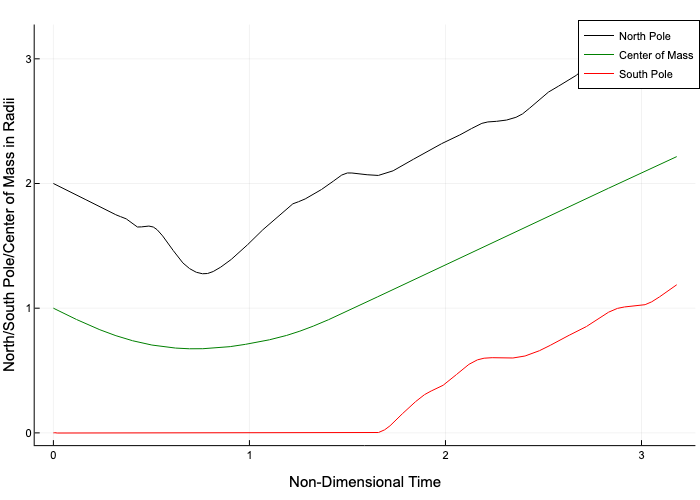

In [17]:
"""
Creating a plot of all north pole, south pole and center of mass heights and saves it to a designated folder.

Inputs/ Uses:
all_north_poles_list (list): List of north poles at every time step.
all_south_poles_list (list): List of south poles at every time step.
all_h_list (list): List of heights of the center of mass of the droplet at every time step.
all_times_list (list): List of all time steps.

Outputs:
plot_path (saved plot): Saves plot on computer.
    
"""

# Time vector
t_intervall = length(all_north_poles_list)
t = range(0, stop=all_north_poles_list[end], length=t_intervall)

# Plot with legend positioning specified up front
plt = Plots.plot(t, all_north_poles_list, label="North Pole", color=:black, legend=:best)
Plots.plot!(plt, t, all_h_list, label="Center of Mass", color=:green)
Plots.plot!(plt, t, all_south_poles_list, label="South Pole", color=:red)

# Axes labels
Plots.xlabel!(plt, "Non-Dimensional Time")
Plots.ylabel!(plt, "North/South Pole/Center of Mass in Radii")

# Save and display
Plots.savefig(plt, "heights_plot.png")
display(plt)

### Maximum Radius


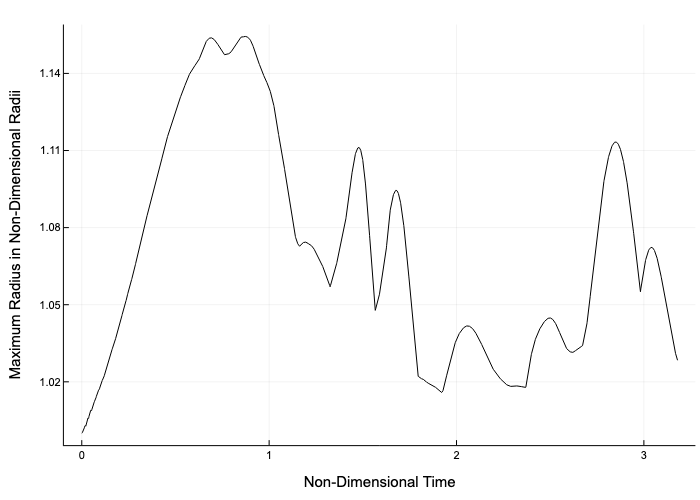

In [18]:
"""
Creates a plot of the maximum droplet radius over time and saves it to a designated path on your computer. 

Inputs/ Uses:
all_maximum_radii_list (list): List of maximum radii at every time step.
t (list): List of all time steps.

Outputs:
plot_path (saved plot): Saves plot on computer.
"""

# Create time vector t for x-axis
t_intervall = length(all_north_poles_list)
t = range(0, stop=all_north_poles_list[end], length=t_intervall)

# Plot and label using Plots.jl explicitly to avoid ambiguity
plt = Plots.plot(
    t, all_maximum_radii_list,
    color=:black,
    xlabel="Non-Dimensional Time",
    ylabel="Maximum Radius in Non-Dimensional Radii",
    legend=false
)
Plots.savefig(plt, "maximum_radius_plot.png")
display(plt)

### Development of Amplitudes


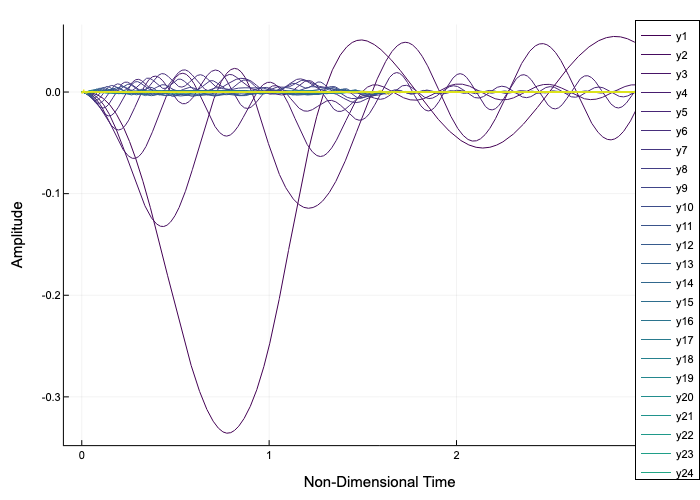

In [19]:
all_amps_arr = hcat(all_amps_list...)' # Convert to array for easier handling

function development_of_amplitudes(all_amps_arr, all_north_poles_list, n_thetas)
    t_intervall = length(all_north_poles_list)
    t = range(0, stop=all_north_poles_list[end], length=t_intervall)

    # Choose colors from viridis colormap
    colors = get(ColorSchemes.viridis, LinRange(0, 1, n_thetas))

    plt = Plots.plot()  # Initialize empty plot

    for amp_ind in 1:(n_thetas - 1)
        coefficients_list = [all_amps_arr[time_ind, amp_ind][1] for time_ind in 1:size(all_amps_arr, 1)]
        Plots.plot!(plt, t, coefficients_list, color=colors[amp_ind])
    end

    Plots.xlabel!(plt, "Non-Dimensional Time")
    Plots.ylabel!(plt, "Amplitude")
    
    display(plt)
end

# Call the function with your data
development_of_amplitudes(all_amps_arr, all_north_poles_list, n_thetas)

## 3D Simulation GIFs


## 3-Axis Droplet Simulation


It is expected that this code cell takes 4-10 min to fully compute the GIF, depending on the frame rate (speeds) and the number of time steps (tend).


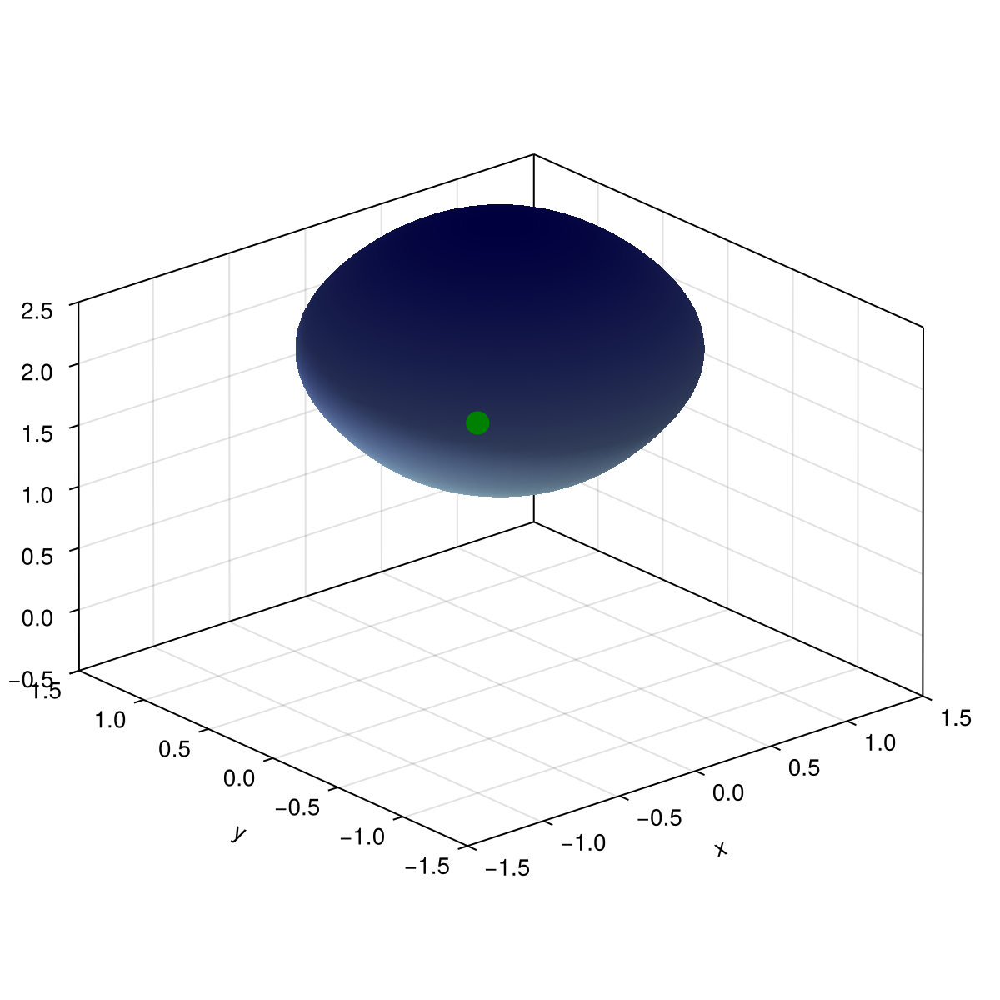

In [20]:
function drop_simulation(all_amps_list, all_h_list, all_m_list, all_times_list,
                         n_thetas_int; speeds=20, view_vertical=20, view_horizontal=50)

    roots, _ = gausslegendre(n_thetas_int)
    cos_theta_vec_plot = vcat(1.0, reverse(roots), -1.0)
    theta_vec_plot = acos.(cos_theta_vec_plot)
    thetas_3D = vcat(-π, -reverse(theta_vec_plot[2:end]), 0.0)
    new_thetas = thetas_3D .+ 3π/2

    all_amps_arr = [all_amps_list[t][m] isa AbstractArray ? all_amps_list[t][m][1] : all_amps_list[t][m]
                    for t in eachindex(all_amps_list), m in eachindex(all_amps_list[1])]

    M = size(all_amps_arr, 2)

    fig = GLMakie.Figure(size=(600, 600))
    ax = GLMakie.Axis3(fig[1,1])
    limits!(ax, (-1.5, 1.5), (-1.5, 1.5), (-0.5, 2.5))
    cam3d!(ax.scene; elevation=view_vertical, azimuth=view_horizontal)

    layers = 60
    φ = range(0, 2π, length=layers)

    x_layer = zeros(n_thetas_int, layers)
    y_layer = zeros(n_thetas_int, layers)
    z_layer = zeros(n_thetas_int, layers)
    radii = ones(n_thetas_int)

    cos_thetas_3D = cos.(thetas_3D) # Precompute cosines for efficiency

    function compute_surface!(x_layer, y_layer, z_layer, radii, z_offset) # Additional function to compute surface
        @inbounds for i in 1:n_thetas_int
            # The simulation is axissymmetryic around the z-axis, so we can use cos and sin directly, and the y-coordinate is derived from the x-coordinate
            x = radii[i] * cos(new_thetas[i])
            z = radii[i] * sin(new_thetas[i]) + z_offset
            for j in 1:layers
                sφ = sin(φ[j])
                cφ = cos(φ[j])
                x_layer[i, j] = x * sφ
                y_layer[i, j] = x * cφ
                z_layer[i, j] = z
            end
        end
    end

    surfaceplot = GLMakie.surface!(ax, x_layer, y_layer, z_layer, colormap=:blues)
    contact = GLMakie.scatter!(ax, [-1], [-1], [2.5], color=:green, markersize=20)

    frame_indices = 1:2:length(all_amps_list)

    GLMakie.record(fig, "droplet.gif", frame_indices; framerate=speeds) do frame
        @inbounds begin
            radii .= 1.0
            for i in 3:M+2
                legendre_values = [Legendre(cos_thetas_3D[ind], i) for ind in 1:n_thetas_int]
                radii .+= all_amps_arr[frame, i - 2] .* legendre_values
            end

            compute_surface!(x_layer, y_layer, z_layer, radii, all_h_list[frame])
            surfaceplot[1] = x_layer
            surfaceplot[2] = y_layer
            surfaceplot[3] = z_layer
            contact.color[] = all_m_list[frame] != 0 ? :red : :green
        end
        return surfaceplot, contact
    end

    return fig
end

# Example call:
tend = 100
times_list = range(0, stop=tend, length=tend + 1)
drop_simulation(all_amps_list, all_h_list, all_m_list, times_list, n_thetas, speeds=20) 

In [21]:
function pressure_simulation(all_press_list, all_times_list, n_thetas_int, speeds)
    legendre_roots, _ = gausslegendre(n_thetas_int)
    float_roots = vcat(reverse(legendre_roots), legendre_roots)

    all_press_arr = [all_press_list[i][j][1] for i in 1:length(all_press_list), j in 1:length(all_press_list[1])]

    n_frames, n_thetas = size(all_press_arr)

    cos_angles = cos.(float_roots) # Pre calculate cosines of angles for efficiency
    pressures = zeros(length(float_roots))

    anim = @animate for n in 1:n_frames
        pressures .= 0.0  # Reset pressures

        @inbounds for i in 1:(n_thetas - 1) # Loop through each Legendre mode
            coeff = all_press_arr[n, i] # Coefficient for the current mode
            # Calculate the pressure contribution for each angle using Legendre polynomial
            # Reminder: Legendre evaluates the polynomial at cos_angles
            pressures .+= coeff .* Legendre.(cos_angles, i)
        end

        Plots.plot(float_roots, pressures; ylim=(-0.1,6), xlim=(-1,1), xlabel="X",
             ylabel="Y", title="Pressure Amplitude", legend=false)
    end every=1

    gif(anim, "pressure_simulation.gif", fps=max(speeds, 1))

    return "GIF saved as pressure_simulation.gif"
end


# Example Call
tend = 100
t = LinRange(0, tend, tend + 1)
pressure_simulation(all_press_list, t, n_thetas, 20) 

[ Info: Saved animation to /Users/marina.levay/Documents/GitHub/drop_simulations/pressure_simulation.gif


"GIF saved as pressure_simulation.gif"